# Analyzing only the predictions and scores

In [1]:
import pandas as pd, numpy as np, scanpy as sc
import plotly
import plotly.express as px
from asctb_ct_label_mapper.utilities.nlp_preprocessing import execute_nlp_pipeline

plotly.offline.init_notebook_mode()




def fetch_and_parse_crosswalk_table(crosswalk_filename='Azimuth_CellTypist_PopV_Lung_ASCTB_Crosswalks.csv', raw_labels_column='raw_input_column', asctb_crosswalk_column='translation_column', verbose=False):
    """Processes the final-crosswalk data containing SME feedback for translating raw-labels into ASCTB naming convention.

    Args:
        crosswalk_filename (str, optional): Defaults to 'Azimuth_CellTypist_PopV_Lung_ASCTB_Crosswalks.csv'.
        raw_labels_column (str, optional): Defaults to 'raw_input_column'.
        asctb_crosswalk_column (str, optional): Defaults to 'translation_column'.
        verbose (bool, optional): Flag to indicate logging in verbose mode. Defaults to False.

    Returns:
        pd.DataFrame: Contains the final-crosswalk information.
    """
    # Merge the aggregated data with the translations file created using our ASCTB-Mapper package with finalized SME feedback
    crosswalk_df = pd.read_csv(crosswalk_filename)

    crosswalk_df['source'] = crosswalk_df['source'].replace('Azimuth-HLCAv2', 'azimuth').replace('PopV-Lung', 'popv').replace('CellTypist-Lung', 'celltypist')

    crosswalk_df[raw_labels_column] = crosswalk_df[raw_labels_column].str.lower().replace('φ','ï†')

    crosswalk_df['asctb_equivalent'] = crosswalk_df[asctb_crosswalk_column].replace('?', np.nan)
    crosswalk_df.loc[crosswalk_df['asctb_equivalent'].isna(), 'asctb_equivalent'] = crosswalk_df.loc[crosswalk_df['asctb_equivalent'].isna(), 'best_matched_asctb_label']
    crosswalk_df['asctb_equivalent'] = crosswalk_df['asctb_equivalent'].str.lower().replace('φ','ï†')
    return crosswalk_df



def get_crosswalk_translation_hmap(crosswalk_df):
    """Create a hashmap of Gloria's crosswalk for cell-type labels from Azimuth/CellTypist/PopV -> ASCTB naming conventions.

    Args:
        crosswalk_df (pd.DataFrame): DataFrame containing final crosswalk information. Essential columns: `[unique_cts, asctb_equivalent]`.
    """
    translation_hmap = dict(
        zip(
            crosswalk_df['unique_cts'], crosswalk_df['asctb_equivalent']
        )
    )
    return translation_hmap




def clean_and_translate_annotation(input_label):
    return ' '.join([execute_nlp_pipeline(word) for word in input_label.split()])




# Read and preprocess the Crosswalk table with SME Feedback to translate annotations -> ASCTB convention
crosswalk_df = fetch_and_parse_crosswalk_table(
    crosswalk_filename='ASCTB_Mapper/Azimuth_CellTypist_PopV_Lung_ASCTB_Crosswalks.csv',
    raw_labels_column='raw_input_label',
    asctb_crosswalk_column='Glorias_recco_for_ASCTB_Crosswalk',
    verbose=False
)


crosswalk_df = crosswalk_df.rename({'raw_input_label':'unique_cts'}, axis=1)
translation_hmap = get_crosswalk_translation_hmap(crosswalk_df)



ANNDATA_FOLDER = 'Datasets'
QUERY_DATASET_NAME = 'LCA'

# "LCA.h5ad" file is pre-annotated
predictions_adata = sc.read_h5ad(f'{ANNDATA_FOLDER}/{QUERY_DATASET_NAME}/{QUERY_DATASET_NAME}.h5ad')


# Get rid of the individual cell-level preds from PopV. Keep only majority_voting in obs dataframe
popv_lung_all_preds_df = pd.read_csv(f'{ANNDATA_FOLDER}/{QUERY_DATASET_NAME}/popv_preds.csv')
popv_lung_all_preds_df['popv_majority_vote_prediction_original'] = popv_lung_all_preds_df['popv_majority_vote_prediction']
for c in 'popv_prediction', 'popv_majority_vote_prediction':
    popv_lung_all_preds_df[c] = popv_lung_all_preds_df[c].apply(lambda x : translation_hmap.get(x.lower().replace('φ','ï†'), x))
popv_lung_preds_df = popv_lung_all_preds_df[['popv_majority_vote_prediction','popv_prediction_score']].rename({'popv_majority_vote_prediction':'raw_predicted_labels'}, axis=1)
popv_lung_preds_df['predicted_labels'] = popv_lung_preds_df['raw_predicted_labels']
predictions_adata.obs['popv_preds'] = popv_lung_preds_df['predicted_labels'].tolist()
predictions_adata.obs['popv_scores'] = popv_lung_preds_df['popv_prediction_score'].tolist()


# Get rid of the individual cell-level preds from CellTypist. Keep only majority_voting in obs dataframe
celltypist_lung_all_preds_df = pd.read_csv(f'{ANNDATA_FOLDER}/{QUERY_DATASET_NAME}/celltypist_preds.csv')
celltypist_lung_all_preds_df['majority_voting_original'] = celltypist_lung_all_preds_df['majority_voting']
for c in ['predicted_labels', 'majority_voting']:
    celltypist_lung_all_preds_df[c] = celltypist_lung_all_preds_df[c].apply(lambda x : translation_hmap.get(x.lower().replace('φ','ï†'), x))
celltypist_lung_preds_df = celltypist_lung_all_preds_df[['majority_voting','conf_score']].rename({'majority_voting':'raw_predicted_labels'}, axis=1)
celltypist_lung_preds_df['predicted_labels'] = celltypist_lung_preds_df['raw_predicted_labels']
predictions_adata.obs['celltypist_preds'] = celltypist_lung_preds_df['predicted_labels'].tolist()
predictions_adata.obs['celltypist_scores'] = celltypist_lung_preds_df['conf_score'].tolist()



# Merge in Azimuth predictions in obs dataframe. Keep only finest level predictions in obs dataframe.
azimuth_lung_all_preds_df = pd.read_csv(f'{ANNDATA_FOLDER}/{QUERY_DATASET_NAME}/azimuth_preds.tsv', sep=' ')
azimuth_lung_all_preds_df['predicted.ann_finest_level_original'] = azimuth_lung_all_preds_df['predicted.ann_finest_level']
for c in ['predicted.ann_level_1','predicted.ann_level_2','predicted.ann_level_3','predicted.ann_level_4','predicted.ann_level_5','predicted.ann_finest_level']:
    azimuth_lung_all_preds_df[c] = azimuth_lung_all_preds_df[c].apply(lambda x : translation_hmap.get(x.lower().replace('φ','ï†'), x))

azimuth_lung_preds_df = azimuth_lung_all_preds_df[['predicted.ann_finest_level', 'predicted.ann_finest_level.score']].rename({'predicted.ann_finest_level':'raw_predicted_labels'}, axis=1)
azimuth_lung_preds_df['predicted_labels'] = azimuth_lung_preds_df['raw_predicted_labels']
predictions_adata.obs['azimuth_preds'] = azimuth_lung_preds_df['predicted_labels'].tolist()
predictions_adata.obs['azimuth_scores'] = azimuth_lung_preds_df['predicted.ann_finest_level.score'].tolist()

predictions_adata.obs.columns

Index(['method', 'donor', 'cell_ontology_type', 'donor_method',
       'cell_ontology_id', 'popv_preds', 'popv_scores', 'celltypist_preds',
       'celltypist_scores', 'azimuth_preds', 'azimuth_scores'],
      dtype='object')

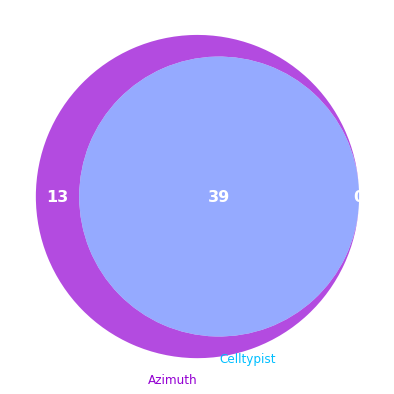

In [2]:
from asctb_ct_label_mapper.utilities.plotting import make_venn_diagram
import plotly.graph_objects as go

try:
    fig = make_venn_diagram(
        A=set(azimuth_lung_all_preds_df['predicted.ann_finest_level_original'].unique().tolist()),
        B=set(celltypist_lung_all_preds_df['majority_voting_original'].unique().tolist()),
        labels=['Azimuth', 'Celltypist']
    )
    fig.show()
except:
    pass



azimuth_raw_preds_not_in_celltypist = \
    set(azimuth_lung_all_preds_df['predicted.ann_finest_level_original'].unique().tolist()) - \
        set(celltypist_lung_all_preds_df['majority_voting_original'].unique().tolist())

azimuth_not_in_celltypist = pd.DataFrame(
    azimuth_lung_all_preds_df.loc[
        azimuth_lung_all_preds_df['predicted.ann_finest_level_original'].isin(azimuth_raw_preds_not_in_celltypist),
        'predicted.ann_finest_level_original'
    ].value_counts().reset_index()
)

azimuth_not_in_celltypist.columns = ['CT', 'count']

azimuth_not_in_celltypist = azimuth_not_in_celltypist.sort_values(by=['CT']).reset_index(drop=True)



fig = go.Figure([
    go.Bar(
        x=azimuth_not_in_celltypist['CT'], 
        y=azimuth_not_in_celltypist['count'], 
        marker_color='rgb(3, 43, 102)', 
        marker_line_color='rgb(8,48,107)', 
        marker_line_width=.8,
        opacity=0.6
        )
    ])

fig.update_layout(
    yaxis={'title':'Count'},
    xaxis={'title':'CellType label', 'categoryorder':'category ascending'}, 
    title=f'{len(azimuth_raw_preds_not_in_celltypist)} Annotation-Labels transferred by Azimuth but not by CellTypist',
    width=800,
    height=500
)

fig.show()

In [3]:
celltypist = pd.DataFrame(celltypist_lung_preds_df['predicted_labels'].value_counts().reset_index())
azimuth = pd.DataFrame(azimuth_lung_preds_df['predicted_labels'].value_counts().reset_index())
popv = pd.DataFrame(popv_lung_preds_df['predicted_labels'].value_counts().reset_index())
celltypist.columns = ['CT','count']
azimuth.columns = ['CT', 'count']
popv.columns = ['CT', 'count']

celltypist = celltypist.sort_values(by=['CT']).reset_index(drop=True)
azimuth = azimuth.sort_values(by=['CT']).reset_index(drop=True)
popv = popv.sort_values(by=['CT']).reset_index(drop=True)
celltypist.head(), azimuth.head(), popv.head()

(                                  CT  count
 0   alveolar fibroblast type 2 cells    592
 1                alveolar macrophage   9004
 2          alveolar macrophage ccl3+   5677
 3  alveolar macrophage proliferating    202
 4         alveolar type 1 fibroblast   1847,
                                   CT  count
 0           airway deuterosomal cell      6
 1   alveolar fibroblast type 2 cells    454
 2                alveolar macrophage   9565
 3          alveolar macrophage ccl3+   4227
 4  alveolar macrophage proliferating    167,
                              CT  count
 0     arterial endothelial cell     11
 1                        b cell    845
 2                    basal cell   1151
 3         bronchial goblet cell    979
 4  bronchial smooth muscle cell   1107)

# Let's look at the unique labels that are common between all 3 sources

A Venn-diagram should suffice.

> !pip install -i https://test.pypi.org/simple/ asctb-ct-label-mapper==0.0.2

Something went wrong with the Venn-diagram creation...[Errno 2] No such file or directory: 'data/threeway_intersection_Crosswalk of annotations to ASCTB naming-convention\nMore agreeability of names enables meaningful comparisons.png'


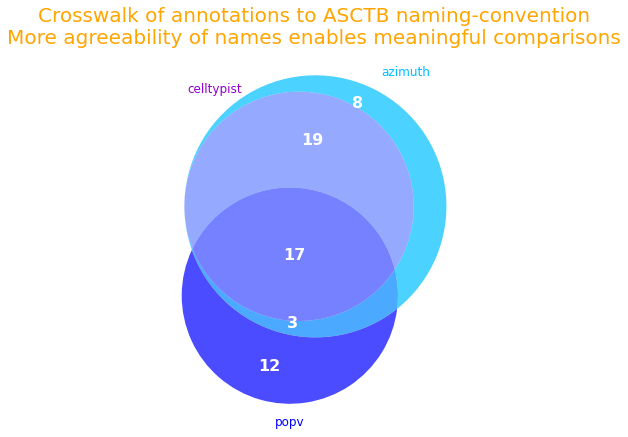

In [4]:
from asctb_ct_label_mapper.utilities.plotting import make_venn_diagram

try:
    make_venn_diagram(
        A=set(celltypist['CT']), 
        B=set(azimuth['CT']), 
        C=set(popv['CT']), 
        labels=['celltypist','azimuth','popv'],
        title='Crosswalk of annotations to ASCTB naming-convention\nMore agreeability of names enables meaningful comparisons'
    )
except Exception as e:
    print(f'Something went wrong with the Venn-diagram creation...{e}')

# The next is an older attempt to view matching standardized-CT-Label names in a sorted-matrix.

Ideally we should be seeing only diagonal elements with dark blocks.

In [5]:
import plotly.express as px



celltypist_title = f'CellTypist ({len(celltypist)})'
azimuth_title = f'Azimuth ({len(azimuth)})'
popv_title = f'PopV ({len(popv)})'
results = np.zeros(shape=(len(celltypist),len(azimuth)))

for i, k1 in enumerate(celltypist['CT']):
    for j, k2 in enumerate(azimuth['CT']):
        if k1==k2:
            results[i,j] = 1 #abs(celltypist.loc[i,'count'] - azimuth.loc[j,'count'])
            break
         


         
fig = px.imshow(
   results,
   labels=dict(
      y=celltypist_title, 
      x=azimuth_title,
      color='Azimuth_pred - CellTypist_preds',
      title='LungMap predictions from Azimuth and CellTypist',
      ),
   y=celltypist.sort_values(by=['CT'], ascending=True)['CT'],
   x=azimuth.sort_values(by=['CT'], ascending=True)['CT'],
   color_continuous_scale='YlGnBu', # YlGn
   aspect='auto'
   )


fig.update_layout(
   title='Cell-Annotations crosswalked to ASCTB: <i>CellTypist</i> vs <i>Azimuth.finest</i>',
   width=1000, 
   height=1000,
   showlegend=False
)
# fig.write_html('Comparing_Train_labels.html')
fig.show()

In [6]:
import plotly.express as px



celltypist_title = f'CellTypist ({len(celltypist)})'
azimuth_title = f'Azimuth ({len(azimuth)})'
popv_title = f'PopV ({len(popv)})'
results = np.zeros(shape=(len(popv),len(celltypist)))

for i, k1 in enumerate(popv['CT']):
    for j, k2 in enumerate(celltypist['CT']):
        if k1==k2:
            results[i,j] = 1 #abs(celltypist.loc[i,'count'] - azimuth.loc[j,'count'])
            break
         


         
fig = px.imshow(
   results,
   labels=dict(
      y=popv_title, 
      x=celltypist_title,
      title='Annotations from PopV and CellTypist',
      ),
   y=popv.sort_values(by=['CT'], ascending=True)['CT'],
   x=celltypist.sort_values(by=['CT'], ascending=True)['CT'],
   color_continuous_scale='YlGnBu', # YlGn
   aspect='auto'
   )


fig.update_layout(
   title='Cell-Annotations crosswalked to ASCTB: <i>PopV</i> vs <i>CellTypist</i>',
   width=1000, 
   height=1000,
   showlegend=False
)
# fig.write_html('Comparing_Train_labels.html')
fig.show()

In [7]:
import plotly.express as px



celltypist_title = f'CellTypist ({len(celltypist)})'
azimuth_title = f'Azimuth ({len(azimuth)})'
popv_title = f'PopV ({len(popv)})'
results = np.zeros(shape=(len(popv),len(azimuth)))

for i, k1 in enumerate(popv['CT']):
    for j, k2 in enumerate(azimuth['CT']):
        if k1==k2:
            results[i,j] = 1 #abs(celltypist.loc[i,'count'] - azimuth.loc[j,'count'])
            break
         


         
fig = px.imshow(
   results,
   labels=dict(
      y=popv_title, 
      x=azimuth_title,
      title='Annotations from PopV and Azimuth',
      ),
   y=popv.sort_values(by=['CT'], ascending=True)['CT'],
   x=azimuth.sort_values(by=['CT'], ascending=True)['CT'],
   color_continuous_scale='YlGnBu', # YlGn
   aspect='auto'
   )


fig.update_layout(
   title='Cell-Annotations crosswalked to ASCTB: <i>PopV</i> vs <i>Azimuth.finest</i>',
   width=1000, 
   height=1000,
   showlegend=False
)
# fig.write_html('Comparing_Train_labels.html')
fig.show()

# Which models show most agreeability in predictions for all cells in our dataset?

# What should we use?

> Azimuth HLCA has 6 annotation-levels (Finest, L5, L4, L3, L2, L1)

> CellTypist has 2 annotation-methods (individual Cell-Prediction, Majority-Voting among cell subclusters)

> PopV has 8 individual predictions from heterogenous models and 1 ensemble prediction after majority-vote.

In [8]:
import random
import plotly.graph_objects as go

get_random_color = lambda: "#"+''.join([random.choice('0123456789ABCDEF') for i in range(6)])

cols = [c for c in azimuth_lung_all_preds_df.columns if 'level' in c and 'score' not in c]
azimuth_preds_counts = pd.DataFrame(azimuth_lung_all_preds_df[cols].nunique()).reset_index()
azimuth_preds_counts.columns = ['prediction_level', 'unique_CTs_detected']
azimuth_preds_counts['colors'] = [get_random_color() for _ in range(azimuth_preds_counts.shape[0])]
azimuth_preds_counts = azimuth_preds_counts.sort_values(by=['prediction_level'], ascending=False)

fig = go.Figure([
    go.Bar(
        x=azimuth_preds_counts['prediction_level'],
        y=azimuth_preds_counts['unique_CTs_detected'],
        marker=dict(color=azimuth_preds_counts['colors'])
    )]
)

fig.update_layout(
    xaxis={'title':'Azimuth Prediction Levels'},
    yaxis={'title':'# Unique CTs'},
    title_text=f'Unique CTs detected at each level of Azimuth\'s HLCA model, for the {QUERY_DATASET_NAME} dataset'
)

fig.show()

In [9]:
from plotly.subplots import make_subplots



def get_matching_count_summaries(predictions1, predictions2, verbose=False):
    """Get stats for one-vs-one prediction comparisons.

    Args:
        predictions1 (pd.Series): Predicted labels from first algorithm (ex- Azimuth).
        predictions2 (pd.Series): Predicted labels from second algorithm (ex- CellTypist).
        verbose (bool, optional): Flag to indicate logging in verbose mode. Defaults to False.

    Returns:
        pd.DataFrame: Summary dataframe containing true/false counts for one-vs-one comparisons of both predicted labels.
    """
    predictions1 = predictions1.reset_index(drop=True)
    predictions2 = predictions2.reset_index(drop=True)
    comparisons = (predictions1==predictions2).value_counts().reset_index()
    if verbose:  print(comparisons)
    comparisons.columns = ['match', 'count']
    comparisons.loc[:, 'match'] = comparisons['match'].apply(lambda x : 'Yes' if x else 'No')
    return comparisons


def add_custom_subplot_of_summaries(predictions1, predictions2, fig, i, j, verbose=False):
    """_summary_

    Args:
        predictions1 (pd.Series): Predicted labels from first algorithm (ex- Azimuth).
        predictions2 (pd.Series): Predicted labels from second algorithm (ex- CellTypist).
        fig (plotly.graph_objects.Figure): Figure containing multiple subplots.
        i (int): Row-Index for subplot position.
        j (int): Col-Index for subplot position.
        verbose (bool, optional): Flag to indicate logging in verbose mode. Defaults to False.

    Returns:
        pd.DataFrame: Summary dataframe containing true/false counts for one-vs-one comparisons of both predicted labels.
    """
    comparisons = get_matching_count_summaries(predictions1, predictions2, verbose)
    comparisons = comparisons.sort_values(by=['match'])
    fig.add_trace(
        go.Pie(
            labels=comparisons['match'], 
            values=comparisons['count'],
            # domain=dict(x=[i,j]),
            marker=dict(colors=['orangered','green']),
            opacity=.7
        ),
        i,
        j
    )
    return comparisons



NROWS = 3
NCOLS = 4
fig = make_subplots(
    rows=NROWS,
    cols=NCOLS,
    subplot_titles=[
        'CellTypist<br>vs<br>Azimuth.finest',
        'CellTypist<br>vs<br>Azimuth.l5',
        'CellTypist<br>vs<br>Azimuth.l4',
        'CellTypist<br>vs<br>Azimuth.l3',
        'Azimuth.finest<br>vs<br>PopularVote',
        'Azimuth.l5<br>vs<br>PopularVote',
        'Azimuth.l4<br>vs<br>PopularVote',
        'Azimuth.l3<br>vs<br>PopularVote',
        '',
        'CellTypist<br>vs<br>PopularVote (Majority Vote)',
        'CellTypist<br>vs<br>PopularVote (Individual identity)'
    ],
    # shared_yaxes=True
    specs = [[{'type':'domain'} for _ in range(NCOLS)]  for _ in range(NROWS)]
)

AZIMUTH_PREDICTION_COLUMN = 'predicted.ann_'
CELLTYPIST_PREDICTION_COLUMN = 'majority_voting'
POPV_PREDICTION_COLUMN = 'popv_majority_vote_prediction'



# CellTypist vs Finest-level Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=celltypist_lung_all_preds_df[CELLTYPIST_PREDICTION_COLUMN].apply(clean_and_translate_annotation), 
    predictions2=azimuth_lung_all_preds_df[f'{AZIMUTH_PREDICTION_COLUMN}finest_level'].apply(clean_and_translate_annotation),
    fig=fig, 
    i=1, j=1
)

# CellTypist vs L5 Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=celltypist_lung_all_preds_df[CELLTYPIST_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    predictions2=azimuth_lung_all_preds_df[f'{AZIMUTH_PREDICTION_COLUMN}level_5'].apply(clean_and_translate_annotation),
    fig=fig, 
    i=1, j=2
)

# CellTypist vs L4 Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=celltypist_lung_all_preds_df[CELLTYPIST_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    predictions2=azimuth_lung_all_preds_df[f'{AZIMUTH_PREDICTION_COLUMN}level_4'].apply(clean_and_translate_annotation),
    fig=fig, 
    i=1, j=3 
)

# CellTypist vs L3 Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=celltypist_lung_all_preds_df[CELLTYPIST_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    predictions2=azimuth_lung_all_preds_df[f'{AZIMUTH_PREDICTION_COLUMN}level_3'].apply(clean_and_translate_annotation),
    fig=fig, 
    i=1, j=4 
)




## Next row
# PopV vs Finest-level Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=popv_lung_all_preds_df[POPV_PREDICTION_COLUMN].apply(clean_and_translate_annotation), 
    predictions2=azimuth_lung_all_preds_df[f'{AZIMUTH_PREDICTION_COLUMN}finest_level'].apply(clean_and_translate_annotation),
    fig=fig, 
    i=2, j=1
)

# PopV vs L5 Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=popv_lung_all_preds_df[POPV_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    predictions2=azimuth_lung_all_preds_df[f'{AZIMUTH_PREDICTION_COLUMN}level_5'].apply(clean_and_translate_annotation),
    fig=fig, 
    i=2, j=2 
)

# PopV vs L4 Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=popv_lung_all_preds_df[POPV_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    predictions2=azimuth_lung_all_preds_df[f'{AZIMUTH_PREDICTION_COLUMN}level_4'].apply(clean_and_translate_annotation),
    fig=fig, 
    i=2, j=3   
)

# PopV vs L3 Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=popv_lung_all_preds_df[POPV_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    predictions2=azimuth_lung_all_preds_df[f'{AZIMUTH_PREDICTION_COLUMN}level_3'].apply(clean_and_translate_annotation),
    fig=fig, 
    i=2, j=4
)






# Final Row
# PopV vs CellTypist : Majority Vote configured
_ = add_custom_subplot_of_summaries(
    predictions1=popv_lung_all_preds_df[POPV_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    predictions2=celltypist_lung_all_preds_df[CELLTYPIST_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    fig=fig, 
    i=3, j=2
)


# PopV vs CellTypist : Majority Vote not configured
CELLTYPIST_PREDICTION_COLUMN = 'predicted_labels'
POPV_PREDICTION_COLUMN = 'popv_prediction'
_ = add_custom_subplot_of_summaries(
    predictions1=popv_lung_all_preds_df[POPV_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    predictions2=celltypist_lung_all_preds_df[CELLTYPIST_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    fig=fig, 
    i=3, j=3
)




fig.update_layout(
    height=800,
    width=800,
    yaxis={'title':'Count'},
    xaxis={'title':'Matching predictions'},
    title_text=f'Reconciling one-to-one annotations for {QUERY_DATASET_NAME} dataset:<br>CellTypist and PopV configured to use Majority-Voting in subclusters<br>Annotations have been crosswalked to ASCTB naming conventions',
    margin=dict(t=200),
    showlegend=False
)
fig.update_traces(textposition='inside')
fig.update_annotations(font_size=12)


# fig.write_html('Reconciling_Predictions_1.html')
fig.show()

## Does assay-type change data-quality leading to agreement changes?

In [10]:
NROWS = 1
NCOLS = 2
fig = make_subplots(
    rows=NROWS,
    cols=NCOLS,
    subplot_titles=[
        '10x:<br>CellTypist<br>vs<br>Azimuth.finest',
        'Smartseq2:<br>CellTypist<br>vs<br>Azimuth.finest',
    ],
    # shared_yaxes=True
    specs = [[{'type':'domain'} for _ in range(NCOLS)]  for _ in range(NROWS)]
)

AZIMUTH_PREDICTION_COLUMN = 'azimuth_preds'
CELLTYPIST_PREDICTION_COLUMN = 'celltypist_preds'
POPV_PREDICTION_COLUMN = 'popv_preds'



# 10x: CellTypist vs Finest-level Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=predictions_adata.obs.loc[predictions_adata.obs['method']=='10X', CELLTYPIST_PREDICTION_COLUMN].apply(clean_and_translate_annotation), 
    predictions2=predictions_adata.obs.loc[predictions_adata.obs['method']=='10X', AZIMUTH_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    fig=fig, 
    i=1, j=1
)

# smartseq2: CellTypist vs Finest-level Azimuth
_ = add_custom_subplot_of_summaries(
    predictions1=predictions_adata.obs.loc[predictions_adata.obs['method']=='smartseq2', CELLTYPIST_PREDICTION_COLUMN].apply(clean_and_translate_annotation), 
    predictions2=predictions_adata.obs.loc[predictions_adata.obs['method']=='smartseq2', AZIMUTH_PREDICTION_COLUMN].apply(clean_and_translate_annotation),
    fig=fig, 
    i=1, j=2
)


fig.update_layout(
    height=500,
    width=800,
    yaxis={'title':'Count'},
    xaxis={'title':'Matching predictions'},
    title_text=f'Reconciling one-to-one annotations for {QUERY_DATASET_NAME} dataset:<br>Annotations have been crosswalked to ASCTB naming conventions',
    margin=dict(t=200),
    showlegend=False
)
fig.update_traces(textposition='inside')
fig.update_annotations(font_size=12)


# fig.write_html('Reconciling_Predictions_1.html')
fig.show()

# Let's look at the distribution of Cell-Labels assigned by each tool

> We'll choose Azimuth HLCA-Finest, and CellTypist-Majority-Voting Cell-Labels.

> Stacked-barchart should work

In [11]:
fig = go.Figure([
    go.Bar(
        x=azimuth['CT'], 
        y=azimuth['count'], 
        name=azimuth_title, 
        marker_color='rgb(3, 43, 102)', 
        marker_line_color='rgb(8,48,107)', 
        marker_line_width=.8,
        opacity=0.6
        ),
    go.Bar(
        x=celltypist['CT'], 
        y=celltypist['count'], 
        name=celltypist_title, 
        marker_color='orange', 
        marker_line_color='rgb(8,48,107)', 
        marker_line_width=.8,
        opacity=0.5
        ),
    go.Bar(
        x=popv['CT'], 
        y=popv['count'], 
        name=popv_title, 
        marker_color='darkgreen', 
        marker_line_color='rgb(8,48,107)', 
        marker_line_width=.8,
        opacity=0.6
        )
    ])

fig.update_layout(
    yaxis={'title':'Count'},
    xaxis={'title':'CellType label', 'categoryorder':'category ascending'}, 
    title=f'Counts for CellType-Label Predictions from Azimuth, CellTypist, PopV on the {QUERY_DATASET_NAME} dataset<br>Annotations have been crosswalked to ASCTB naming conventions',
    barmode='stack',
    # yaxis_type='log',
    width=1500,
    height=1000
    )

fig.show()

## Let's look at the scores now

We'll also normalize the PopV scores since it's just the number of classifiers agreeing with a prediction (ranges from 1-8).

In [12]:
comprehensive_comparison_df = pd.DataFrame()

comprehensive_comparison_df['popv_preds'] = predictions_adata.obs['popv_preds'].tolist()
comprehensive_comparison_df['popv_scores'] = predictions_adata.obs['popv_scores'].tolist()
comprehensive_comparison_df['popv_scores'] = (comprehensive_comparison_df['popv_scores'] - comprehensive_comparison_df['popv_scores'].min())/(comprehensive_comparison_df['popv_scores'].max() - comprehensive_comparison_df['popv_scores'].min())

comprehensive_comparison_df['celltypist_preds'] = predictions_adata.obs['celltypist_preds'].tolist()
comprehensive_comparison_df['celltypist_scores'] = predictions_adata.obs['celltypist_scores'].tolist()

comprehensive_comparison_df['azimuth_preds'] = predictions_adata.obs['azimuth_preds'].tolist()
comprehensive_comparison_df['azimuth_scores'] = predictions_adata.obs['azimuth_scores'].tolist()


# Create pairwise-agreement columns
AGREEEMENT_COLUMNS = ['celltypist_azimuth_preds_agree', 'popv_celltypist_preds_agree', 'azimuth_popv_preds_agree']

comprehensive_comparison_df['celltypist_azimuth_preds_agree'] = comprehensive_comparison_df['celltypist_preds'] == comprehensive_comparison_df['azimuth_preds']
comprehensive_comparison_df['popv_celltypist_preds_agree'] = comprehensive_comparison_df['popv_preds'] == comprehensive_comparison_df['celltypist_preds']
comprehensive_comparison_df['azimuth_popv_preds_agree'] = comprehensive_comparison_df['azimuth_preds'] == comprehensive_comparison_df['popv_preds']

# Create overview agreeement columns
comprehensive_comparison_df['two_preds_agree'] = comprehensive_comparison_df[AGREEEMENT_COLUMNS].eq(True).any(axis=1)
comprehensive_comparison_df['all_preds_agree'] = comprehensive_comparison_df[AGREEEMENT_COLUMNS].eq(True).all(axis=1)


comprehensive_comparison_df.head()

,popv_preds,popv_scores,celltypist_preds,celltypist_scores,azimuth_preds,azimuth_scores,celltypist_azimuth_preds_agree,popv_celltypist_preds_agree,azimuth_popv_preds_agree,two_preds_agree,all_preds_agree
0,non-classical monocyte,1.000000,cap2 aerocyte capillary acap,1.0,cap2 aerocyte capillary acap,1.000000,True,False,False,True,False
1,non-classical monocyte,0.666667,cap2 aerocyte capillary acap,1.0,cap2 aerocyte capillary acap,1.000000,True,False,False,True,False
2,non-classical monocyte,0.833333,cap2 aerocyte capillary acap,1.0,cap2 aerocyte capillary acap,0.990189,True,False,False,True,False
3,non-classical monocyte,0.833333,cap2 aerocyte capillary acap,1.0,cap2 aerocyte capillary acap,1.000000,True,False,False,True,False
4,non-classical monocyte,0.666667,cap2 aerocyte capillary acap,1.0,cap2 aerocyte capillary acap,0.946737,True,False,False,True,False


In [13]:
fig = go.Figure([
    go.Histogram(
        name='Azimuth.Finest scores',
        x=comprehensive_comparison_df.loc[:, 'azimuth_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.75
    ),
    go.Histogram(
        name='CellTypist.MajorityVote scores',
        x=comprehensive_comparison_df.loc[:, 'celltypist_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.75
    ),
    go.Histogram(
        name='PopV.MajorityVote scores',
        x=comprehensive_comparison_df.loc[:, 'popv_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.9
    )
])


num_examples = comprehensive_comparison_df.shape[0]

fig.update_layout(
    yaxis={'title':'# of observations'},
    xaxis={'title':'Prediction scores'},
    margin=dict(t=210),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=[{'yaxis.type': 'linear'}],
                    label='Linear scale',
                    method='relayout'
                ),
                dict(
                    args=[{'yaxis.type': 'log'}],
                    label='Log Scale',
                    method='relayout'
                )
            ]),
            direction='down',
            showactive=True,
            x=1.,
            y=1.15
        )
    ],
    title_text=f'Let\'s just look at all 3 score distributions:\
        <br><b>Fairly Left skewed</b> distribution with high variance for <b>Azimuth scores</b>: Mostly preds have medium/high confidence\
            <br><b>Biomodal</b> distribution with high variance for <b>CellTypist scores</b>:  Majority vote complicates interpretability\
                <br><b>Discrete</b> distribution of <b>PopV scores</b>: Mostly all 8 classifiers agree (1-8)'
)

fig.show()

In [14]:
# from scipy.stats import mannwhitneyu


# U1, p = mannwhitneyu(
#     predictions_adata.obs.loc[:, 'azimuth_scores'], 
#     predictions_adata.obs.loc[:, 'celltypist_scores'], 
#     method='exact'
# )

# print(f'For overall score-distribution of Azimuth vs that of CellTypist: p-value = {p}')

### Now let's look at stratified distributions based on agreement/disagreement between the 3 modalities

In [15]:
fig = go.Figure([
    go.Histogram(
        name='Azimuth.Finest scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['two_preds_agree']==False, 'azimuth_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.75
    ),
    go.Histogram(
        name='CellTypist.MajorityVote scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['two_preds_agree']==False, 'celltypist_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.75
    ),
    go.Histogram(
        name='PopV.MajorityVote scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['two_preds_agree']==False, 'popv_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.9
    )
])


num_disagreements = comprehensive_comparison_df.loc[comprehensive_comparison_df['two_preds_agree']==False, :].shape[0]

fig.update_layout(
    yaxis={'title':'# of mismatches'},
    xaxis={'title':'Prediction scores'},
    margin=dict(t=150),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=[{'yaxis.type': 'linear'}],
                    label='Linear scale',
                    method='relayout'
                ),
                dict(
                    args=[{'yaxis.type': 'log'}],
                    label='Log Scale',
                    method='relayout'
                )
            ]),
            direction='down',
            showactive=True,
            x=1.,
            y=1.1
        )
    ],
    title_text=f'Q. Dow we have low prediction scores for the {num_disagreements} cases when no predictions agree?\
        <br><b>Fairly Left skewed</b> distribution with high variance for <b>Azimuth scores</b>: Mostly preds have medium/high confidence\
            <br><b>Biomodal</b> distribution with high variance for <b>CellTypist scores</b>:  Majority vote complicates interpretability\
                <br><b>Discrete</b> distribution of <b>PopV scores</b>: Mostly all 8 classifiers agree (1-8)'
)


fig.show()

In [16]:
fig = go.Figure([
    go.Histogram(
        name='Azimuth.Finest scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['two_preds_agree']==True, 'azimuth_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.75
    ),
    go.Histogram(
        name='CellTypist.MajorityVote scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['two_preds_agree']==True, 'celltypist_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.75
    ),
    go.Histogram(
        name='PopV.MajorityVote scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['two_preds_agree']==True, 'popv_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.9
    )
])

num_agreements = comprehensive_comparison_df.loc[comprehensive_comparison_df['two_preds_agree']==True, :].shape[0]

fig.update_layout(
    yaxis={'title':'# of matches'},
    xaxis={'title':'Prediction scores'},
    margin=dict(t=150),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=[{'yaxis.type': 'linear'}],
                    label='Linear scale',
                    method='relayout'
                ),
                dict(
                    args=[{'yaxis.type': 'log'}],
                    label='Log Scale',
                    method='relayout'
                )
            ]),
            direction='down',
            showactive=True,
            x=1.,
            y=1.1
        )
    ],
    title_text=f'Q. Do we have high prediction scores for the {num_agreements} cases when there exists pairwise prediction-agreement?\
        <br><b>Fairly Left skewed</b> distribution with high variance for <b>Azimuth scores</b>: Mostly preds have medium/high confidence\
            <br><b>Biomodal</b> distribution with high variance for <b>CellTypist scores</b>:  Majority vote complicates interpretability\
                <br><b>Discrete</b> distribution of <b>PopV scores</b>: Mostly all 8 classifiers agree (1-8)'
)


fig.show()

In [17]:
fig = go.Figure([
    go.Histogram(
        name='Azimuth.Finest scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['all_preds_agree']==True, 'azimuth_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.75
    ),
    go.Histogram(
        name='CellTypist.MajorityVote scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['all_preds_agree']==True, 'celltypist_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.75
    ),
    go.Histogram(
        name='PopV.MajorityVote scores',
        x=comprehensive_comparison_df.loc[comprehensive_comparison_df['all_preds_agree']==True, 'popv_scores'],
        nbinsx=1000,
        marker_color=get_random_color(),
        marker=dict(line=dict(width=.1, color='darkblue')),
        opacity=0.9
    )
])

num_agreements = comprehensive_comparison_df.loc[comprehensive_comparison_df['all_preds_agree']==True, :].shape[0]

fig.update_layout(
    yaxis={'title':'# of matches'},
    xaxis={'title':'Prediction scores'},
    margin=dict(t=150),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=[{'yaxis.type': 'linear'}],
                    label='Linear scale',
                    method='relayout'
                ),
                dict(
                    args=[{'yaxis.type': 'log'}],
                    label='Log Scale',
                    method='relayout'
                )
            ]),
            direction='down',
            showactive=True,
            x=1.,
            y=1.1
        )
    ],
    title_text=f'Q. Do we have high prediction scores for the {num_agreements} cases when all 3 predictions match?\
        <br><b>Left skewed</b> distribution for <b>Azimuth scores</b>: Mostly preds have medium/high confidence\
            <br><b>Left skewed</b> distribution for <b>CellTypist scores</b>:  Majority vote complicates interpretability\
                <br><b>Discrete</b> distribution of <b>PopV scores</b>: Mostly all 8 classifiers agree (1-8)',
)


fig.show()

## Which HLCA Labels did the Azimuth model not transfer over to query dataset at all?

> Are these rare CTs?

In [18]:
from requests import get
from pprint import pprint
import base64, json

def get_specific_azimuth_marker_genes(filename='hlca_level1.csv', verbose=False):
    """Accesses the Github repo for Azimuth, and pulls the lung-information from specific URLs.
    
    Args:
        verbose (bool, optional): Flag to indicate logging in verbose mode. Defaults to False.
    
    Return:
        pd.DataFrame
    """
    USER = 'satijalab'
    REPOSITORY_NAME = 'azimuth_website'
    FILE_PATH = f'/static/csv/{filename}'
    URL = f'https://raw.githubusercontent.com/{USER}/{REPOSITORY_NAME}/master/{FILE_PATH}'
    df = pd.read_csv(URL, index_col=0)
    if verbose:  print(f'data = \n{df}')
    return df




def get_all_azimuth_marker_genes(organ='lung', verbose=False):
    """Accesses the Github repo for Azimuth, and pulls the lung-information from below URLs.
    `https://github.com/satijalab/azimuth_website/blob/master/static/csv/hlca_level1.csv`,
    `https://github.com/satijalab/azimuth_website/blob/master/static/csv/hlca_level2.csv`,
    `https://github.com/satijalab/azimuth_website/blob/master/static/csv/hlca_level3.csv`,
    `https://github.com/satijalab/azimuth_website/blob/master/static/csv/hlca_level4.csv`,
    `https://github.com/satijalab/azimuth_website/blob/master/static/csv/hlca_level5.csv`,
    `https://github.com/satijalab/azimuth_website/blob/master/static/csv/hlca_finest_level.csv`

    There are also some naming-convention issues to be fixed:
        The Azimuth HLCA_finest marker-genes file, contains "non classical monocytes" and "transitional club at2" while the 
        actual algorithm predictions are "non-classical monocytes" and "transitional club-at2" respectively.

    Args:
        organ (str, optional): Defaults to 'lung'.
        verbose (bool, optional): Flag to indicate logging in verbose mode. Defaults to False.

    Returns:
        pd.DataFrame: Columns are [`'Label'`, `'Markers'`].
    """
    azimuth_marker_genes_df = pd.DataFrame()
    if organ=='lung':
        FILENAMES = ['hlca_finest_level']
    for filename in FILENAMES:
        if verbose:  print(f'Trying to access {filename} in Azimuth Github-Repo.')
        curr_marker_genes_df = get_specific_azimuth_marker_genes(filename=f'{filename}.csv', verbose=verbose)
        curr_marker_genes_df = curr_marker_genes_df[['Label','Markers']]
        azimuth_marker_genes_df = pd.concat([azimuth_marker_genes_df, curr_marker_genes_df]).drop_duplicates(subset=['Label'])
    azimuth_marker_genes_df.columns = ['unique_cts', 'azimuth_markers']
    azimuth_marker_genes_df['unique_cts'] = azimuth_marker_genes_df['unique_cts']#.str.lower().replace('φ','ï†')
    
    # Fixing some clearly naming-convention issues.
    azimuth_marker_genes_df.loc[azimuth_marker_genes_df['unique_cts']=='non classical monocytes' , 'unique_cts'] = 'non-classical monocytes'
    azimuth_marker_genes_df.loc[azimuth_marker_genes_df['unique_cts']=='transitional club at2' , 'unique_cts'] = 'transitional club-at2'
    azimuth_marker_genes_df = azimuth_marker_genes_df.reset_index(drop=True)
    return azimuth_marker_genes_df



# Parse all CT-names from Azimuth finest HLCA model: What CTs can Azimuth detect?
azimuth_all_labels_df = get_all_azimuth_marker_genes(organ='lung', verbose=False)
ALL_LABELS_COLUMN = 'unique_cts'
azimuth_all_labels_df[ALL_LABELS_COLUMN+'_cleaned'] = azimuth_all_labels_df[ALL_LABELS_COLUMN].apply(lambda x : execute_nlp_pipeline(x).lower().replace('φ','ï†'))



# Parse all CT-names from Azimuth predictions: What CTs has Azimuth detected?
azimuth_lung_preds_df = pd.read_csv(f'{ANNDATA_FOLDER}/{QUERY_DATASET_NAME}/azimuth_preds.tsv', sep=' ')
PREDICTED_LABELS_COLUMN = 'predicted.ann_finest_level'

azimuth_lung_preds_df[PREDICTED_LABELS_COLUMN+'_cleaned'] = azimuth_lung_preds_df[PREDICTED_LABELS_COLUMN].apply(lambda x : execute_nlp_pipeline(x).lower().replace('φ','ï†'))
azimuth_lung_preds_df = azimuth_lung_preds_df[[PREDICTED_LABELS_COLUMN, PREDICTED_LABELS_COLUMN+'_cleaned']]


    

# Perform left-join and identify missing entries
azimuth_non_transferred_labels_df = pd.merge(
    left=azimuth_all_labels_df, 
    right=azimuth_lung_preds_df,
    how='left', 
    left_on=ALL_LABELS_COLUMN+'_cleaned',
    right_on=PREDICTED_LABELS_COLUMN+'_cleaned'
)
azimuth_non_transferred_labels_df = azimuth_non_transferred_labels_df.loc[azimuth_non_transferred_labels_df[PREDICTED_LABELS_COLUMN].isna()]



# Verify if data looks good
reference_predicted = set(azimuth_all_labels_df[ALL_LABELS_COLUMN+'_cleaned'].unique().tolist())
predicted = set(azimuth_lung_preds_df[PREDICTED_LABELS_COLUMN+'_cleaned'].unique().tolist())
pprint(reference_predicted - predicted)


azimuth_non_transferred_labels_df.sort_values(by=[ALL_LABELS_COLUMN])[ALL_LABELS_COLUMN]

{'alveolarmmtpositive',
 'gobletsubsegmental',
 'lymphaticecdifferentiating',
 'lymphaticecproliferating',
 'smactivatedstressresponse',
 'smgserousnasal'}


74798         Alveolar Mφ MT-positive
72469           Goblet (subsegmental)
66626    Lymphatic EC differentiating
75059      Lymphatic EC proliferating
41459    SM activated stress response
74767              SMG serous (nasal)
Name: unique_cts, dtype: object

## Which Labels did the PopV model not transfer over to query dataset at all?

> Are these rare CTs?

In [19]:
# Parse all CT-names from PopV model: What CTs can PopV detect?
POPV_REF_DATASET = 'TS_Lung_Filtered'
popv_ref_adata = sc.read_h5ad(f'{ANNDATA_FOLDER}/{POPV_REF_DATASET}/{POPV_REF_DATASET}.h5ad')
ALL_LABELS_COLUMN = 'cell_ontology_class'
popv_all_labels_df = pd.DataFrame(popv_ref_adata.obs[ALL_LABELS_COLUMN].unique().tolist(), columns=[ALL_LABELS_COLUMN])
del popv_ref_adata

popv_all_labels_df[ALL_LABELS_COLUMN+'_cleaned'] = popv_all_labels_df[ALL_LABELS_COLUMN].apply(lambda x : execute_nlp_pipeline(x).lower().replace('φ','ï†'))



# Parse all CT-names from popv predictions: What CTs has popv detected?
popv_lung_preds_df = pd.read_csv(f'{ANNDATA_FOLDER}/{QUERY_DATASET_NAME}/popv_preds.csv')
PREDICTED_LABELS_COLUMN = 'popv_majority_vote_prediction'
popv_lung_preds_df[PREDICTED_LABELS_COLUMN+'_cleaned'] = popv_lung_preds_df[PREDICTED_LABELS_COLUMN].apply(lambda x : execute_nlp_pipeline(x).lower().replace('φ','ï†'))




# Perform left-join and identify missing entries
popv_non_transferred_labels_df = pd.merge(
    left=popv_all_labels_df, 
    right=popv_lung_preds_df,
    how='left', 
    left_on=ALL_LABELS_COLUMN+'_cleaned',
    right_on=PREDICTED_LABELS_COLUMN+'_cleaned'
)
popv_non_transferred_labels_df = popv_non_transferred_labels_df.loc[popv_non_transferred_labels_df[PREDICTED_LABELS_COLUMN+'_cleaned'].isna()]



# Verify if data looks good
predicted = set(popv_lung_preds_df[PREDICTED_LABELS_COLUMN+'_cleaned'].unique().tolist())
reference_predicted = set(popv_all_labels_df[ALL_LABELS_COLUMN+'_cleaned'].unique().tolist())
pprint(reference_predicted - predicted)


popv_non_transferred_labels_df.sort_values(by=[ALL_LABELS_COLUMN])[ALL_LABELS_COLUMN]

C:\ProgramData\Anaconda3\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning:

Transforming to str index.



{'effectorcd8positivealphabetatcell'}


5239    effector CD8-positive, alpha-beta T cell
Name: cell_ontology_class, dtype: object

## Sankey plot to show how cells (rows in the CxG matrix) are assigned amongst the 3 modalities

In [20]:
# !pip install floweaver ipysankeywidget

In [21]:
!jupyter nbextension enable --py --sys-prefix ipysankeywidget

Enabling notebook extension jupyter-sankey-widget/extension...
      - Validating: ok


In [33]:
!jupyter nbextension enable widgetsnbextension --user --py

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok


In [ ]:
from sklearn.preprocessing import OrdinalEncoder


OrdinalEncoder(popv_preds)

In [35]:
# # define node IDs and labels
# node_ids = predictions_adata.obs['azimuth_preds'].unique().tolist()
# labels = node_ids

# # find unique values in popv_preds that are not in azimuth_preds
# missing_nodes = list(set(predictions_adata.obs['popv_preds'].unique()) - set(node_ids))

# # append missing nodes to node_ids and labels
# node_ids += missing_nodes
# labels += missing_nodes

# # create source and target indices
# source = predictions_adata.obs['azimuth_preds'].apply(lambda x: node_ids.index(x))
# target = predictions_adata.obs['celltypist_preds'].apply(lambda x: node_ids.index(x))

# # create Sankey plot
# fig = go.Figure(data=[go.Sankey(
#     node=dict(
#         pad=15,
#         thickness=20,
#         line=dict(color="black", width=0.5),
#         label=labels,
#         color="blue"
#     ),
#     link=dict(
#         source=source,
#         target=target,
#         value=[1]*len(predictions_adata.obs)
#     ))])

# fig.show()
# print('Commenting out as it leads to a very heavy visualization')



import floweaver as fw
from ipysankeywidget import SankeyWidget


sankey_src = 'azimuth_preds'
sankey_tgt = 'celltypist_preds'
sankey_df = comprehensive_comparison_df[[sankey_src, sankey_tgt]]

sankey_df = sankey_df.groupby(by=[sankey_src, sankey_tgt], as_index=True)[sankey_tgt].agg({'count'})
sankey_df = sankey_df.reset_index()

sankey_df.columns = ['source', 'target', 'value']
sankey_df['type'] = 'temp'
SankeyWidget(links=sankey_df.to_dict('records'))

SankeyWidget(links=[{'source': 'airway deuterosomal cell', 'target': 'ciliated airway epithelial cell without …

## What are the average prediction scores from CellTypist and Azimuth for the 8 discrete scores of PopV?

In [24]:
dropdown_options = [
    {
        'label': 'Reset',
        'method': 'update',
        'args': [
            {
                'x': [
                    predictions_adata.obs.loc[:, 'azimuth_scores'],
                    predictions_adata.obs.loc[:, 'celltypist_scores']
                ]
            },
            {
                'title' : f'Density Estimation of Azimuth and CellTypist Scores for all discrete PopV-Scores<br>{predictions_adata.obs.shape[0]} observations'
            }
        ]
    }
]

for group in reversed(sorted(predictions_adata.obs['popv_scores'].unique())):
    dropdown_options.append(
        {
            'label': str(group),
            'method': 'update',
            'args': [
                {
                    'x': [
                        predictions_adata.obs.loc[predictions_adata.obs['popv_scores'] == group, 'azimuth_scores'],
                        predictions_adata.obs.loc[predictions_adata.obs['popv_scores'] == group, 'celltypist_scores']
                    ],
                },
                {
                    'title' : f'Density Estimation of Azimuth and CellTypist Scores for PopV-Score = {group}<br>{predictions_adata.obs.loc[predictions_adata.obs["popv_scores"] == group, "popv_scores"].shape[0]} observations.'
                }
            ]
        }
    )


fig = go.Figure(
    data=[
        go.Histogram(
            x=predictions_adata.obs['azimuth_scores'], 
            name='Azimuth Scores'
        ),
        go.Histogram(
            x=predictions_adata.obs['celltypist_scores'], 
            name='Celltypist Scores'
        )
    ]
)

fig.update_layout(
    title=f'Density Estimation of Azimuth and CellTypist Scores for all discrete PopV-Scores<br>{predictions_adata.obs.shape[0]} observations',
    xaxis_title='Scores',
    yaxis_title='Density',
    updatemenus=[
        {
            'buttons': dropdown_options, 
            'direction': 'down', 
            'showactive': True, 
            'x': 1.1, 
            'y': 1.15
        }
    ]
)

fig.show()


predictions_adata.obs.groupby(by=['popv_scores'], as_index=False).agg(
    {
        'azimuth_scores':['count', 'mean'],
        'celltypist_scores':'mean'
    }
).sort_values(by=['popv_scores'], ascending=[False])

popv_scores azimuth_scores           celltypist_scores
                       count      mean              mean
6           8          49232  0.891793          0.933231
5           7          14932  0.900656          0.941251
4           6           5182  0.890506          0.942473
3           5           3140  0.881209          0.933712
2           4           2054  0.881731          0.932922
1           3            504  0.891485          0.932369
0           2             27  0.902481          0.999254

## Mann-Whitney U test 

Non-parametric test to check if distributions of Azimuth/CellTypist scores are similar, for facets of PopV-scores.

#### ! Running into RAM allocation issues !

In [25]:
from scipy.stats import mannwhitneyu


U1, p = mannwhitneyu(
    predictions_adata.obs.iloc[:, predictions_adata.obs.columns.get_loc('azimuth_scores')],
    predictions_adata.obs.iloc[:, predictions_adata.obs.columns.get_loc('celltypist_scores')],
    method='exact'
)

print(f'For overall score-distribution of Azimuth vs that of CellTypist: p-value = {p}')

MemoryError: Unable to allocate 58.0 GiB for an array with shape (7783138690,) and data type int64